In [1]:
import numpy as np
import pandas as pd
import os
import torch
import pingouin as pg
from tqdm import tqdm
from nilearn import datasets
from nilearn import plotting
import pandas as pd
import seaborn as sns
import matplotlib as mpl
import matplotlib.pyplot as plt
from scipy.stats import pearsonr, spearmanr
from scipy.spatial.distance import correlation
from torch.utils.data import DataLoader, Dataset, Subset
from nilearn.connectome import sym_matrix_to_vec
from sklearn.manifold import TSNE
from ContModeling.helper_classes import MatData
from ContModeling.models import PhenoProj
from hydra import initialize, compose
from omegaconf import DictConfig, OmegaConf
import xarray as xr
from neuromaps.datasets import fetch_fslr
from brainspace.utils.parcellation import map_to_labels, reduce_by_labels
from brainspace.datasets import load_conte69, load_parcellation
from brainspace.plotting import plot_hemispheres
from surfplot import Plot
import nilearn as nl
from statsmodels.robust.scale import Huber
from ContModeling.viz_func import replace_with_network


In [2]:
mpl.rcParams['svg.fonttype'] = 'none'

In [150]:
dataset_name = "hcp"
domain = "cog"
dataset_path = f"data/{dataset_name}_400parcels.nc"

In [151]:
dataset = xr.open_dataset(dataset_path)

In [68]:
import scipy.io as sio
kong_parcellation = sio.loadmat('HCP_1029sub_400Parcels_Kong2022_gMSHBM.mat')


In [69]:
surfaces = fetch_fslr()
lh, rh = surfaces['veryinflated']
# lh_parc, rh_parc = load_parcellation('schaefer', 400)
lh_parc, rh_parc = kong_parcellation['lh_labels_all'][:, 0], kong_parcellation['rh_labels_all'][:, 0]
schaefer_labels = load_parcellation('schaefer', scale=400, join=True)

In [70]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [71]:
mode = "shuffle"
domain = "cog"
with initialize(version_base=None, config_path="."):
    cfg = compose(config_name=f'{mode}_main_model_config.yaml')
    print(OmegaConf.to_yaml(cfg))

project: HCP_SHUFFLE_REDMAT_DEC_MULTIVAR_PSY_ONLY
experiment_name: shuffle_redmat_dec_hcp_multivar_psy_only
hypothesis: '-'
input_dim_feat: 400
output_dim_feat: 100
hidden_dim: 128
input_dim_target: 17
output_dim_target: 64
random_seed:
- 1001
- 42
- 54
- 90
- 101
- 80
- 422
- 142
- 128
- 340
skip_conn: false
skip_enc1: false
ReEig: false
full_model_pretrained: true
mat_ae_pretrained: false
reduced_mat_ae_pretrained: false
mat_ae_pretrained_exp: shuffle_pretrain_mat_ae_hcp
pretrained_reduced_mat_ae_exp: ext_sup_reduced_mat_ae_abcd
full_model_pretrained_exp: shuffle_redmat_enc_hcp_multivar_psy_only
mat_ae_enc_freeze: true
mat_ae_dec_freeze: true
reduced_mat_ae_enc_freeze: true
reduced_mat_ae_dec_freeze: false
target_dec_freeze: true
best_mat_ae_fold: 2
best_reduced_mat_ae_fold: 4
synth_exp: false
multi_gpu: true
num_epochs: 500
batch_size: 256
n_runs: 1
lr: 0.001
weight_decay: 0.0001
dropout_rate: 0
scheduler_patience: 20
test_ratio: 0.3
train_ratio:
- 1.0
log_gradients: true
clip_grad:

In [72]:
data_path = cfg.dataset.dataset_path
results_path = './results'

In [73]:
# fig_dir = os.path.join(results_path, f"{mode}_redmat_dec_abcd_multivar_{domain}_only", 'figures')
fig_dir = "./figures"

## Model Viz

In [74]:
# MODEL DIMS
input_dim_feat = cfg.input_dim_feat
input_dim_target = cfg.input_dim_target
hidden_dim = cfg.hidden_dim
output_dim_target = cfg.output_dim_target
output_dim_feat = cfg.output_dim_feat
# kernel = SUPCON_KERNELS[cfg.SupCon_kernel]

# TRAINING PARAMS
lr = cfg.lr
batch_size = cfg.batch_size
dropout_rate = cfg.dropout_rate
weight_decay = cfg.weight_decay
num_epochs = cfg.num_epochs

In [75]:
model = PhenoProj(
    input_dim_feat,
    input_dim_target,
    hidden_dim,
    output_dim_target,
    output_dim_feat,
    dropout_rate,
    cfg
).to(device)

In [21]:
state_dict = torch.load(f"{results_path}/{cfg.experiment_name}/saved_models/model_weights_run0.pth", map_location=torch.device('cpu'))
model.load_state_dict(state_dict)


/tmp/slurm-24296530/ipykernel_1601237/3432621027.py:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state_dict = torch.load(f"{results_path}/{cfg.experiment_name}/saved_mod

<All keys matched successfully>

In [5]:
dataset = xr.open_dataset(data_path)

In [13]:
matrix = dataset.matrices.isel(subject = 100).values

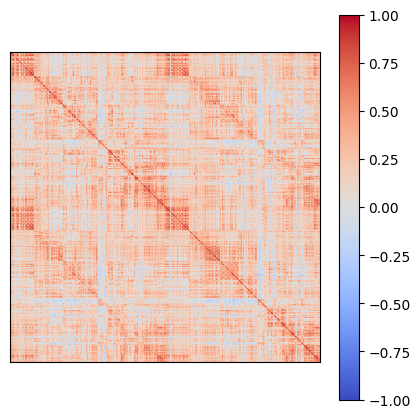

In [14]:
fig, ax = plt.subplots(figsize=(5, 5))
plt.imshow(matrix, cmap='coolwarm', vmax=1, vmin=-1)
plt.colorbar()
ax.set_xticks([])
ax.set_yticks([])
fig.savefig(f"./abstract_viz/original_matrix.svg", format = "svg", dpi = 300, bbox_inches='tight')

In [11]:
matrix_tensor = torch.Tensor(matrix)

In [12]:
enc_mat_1 = model.matrix_ae.enc_mat1(matrix_tensor.to(device))

In [13]:
enc_mat_1.shape

torch.Size([400, 100])

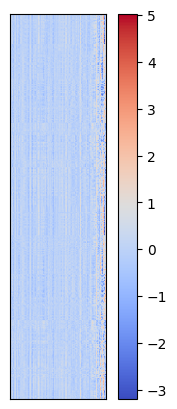

In [14]:
fig, ax = plt.subplots(figsize=(3, 5))
plt.imshow(enc_mat_1.cpu().detach().numpy(), cmap='coolwarm')
plt.colorbar()
ax.set_xticks([])
ax.set_yticks([])
fig.savefig(f"./abstract_viz/enc1_matrix.svg", format = "svg", dpi = 300, bbox_inches='tight')

In [15]:
model.matrix_ae.enc_mat2.weight.shape

torch.Size([100, 400])

In [16]:
enc_mat_1.transpose(0, 1).shape


torch.Size([100, 400])

In [17]:
enc_mat_2 = model.matrix_ae.enc_mat2(enc_mat_1.permute(1, 0))

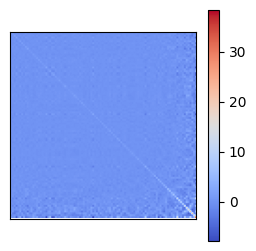

In [18]:
fig, ax = plt.subplots(figsize=(3, 3))
plt.imshow(enc_mat_2.cpu().detach().numpy(), cmap='coolwarm')
plt.colorbar()
ax.set_xticks([])
ax.set_yticks([])
fig.savefig(f"./abstract_viz/enc2_matrix.svg", format = "svg", dpi = 300, bbox_inches='tight')

In [19]:
dec_mat_1 = model.matrix_ae.dec_mat1(enc_mat_2).permute(1, 0)

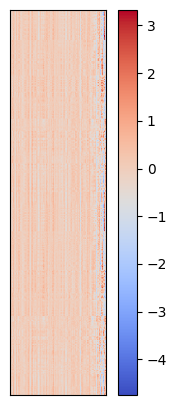

In [20]:
fig, ax = plt.subplots(figsize=(3, 5))
plt.imshow(dec_mat_1.cpu().detach().numpy(), cmap='coolwarm')
plt.colorbar()
ax.set_xticks([])
ax.set_yticks([])
fig.savefig(f"./abstract_viz/dec1_matrix.svg", format = "svg", dpi = 300, bbox_inches='tight')

In [21]:
dec_mat_2 = model.matrix_ae.dec_mat2(dec_mat_1)

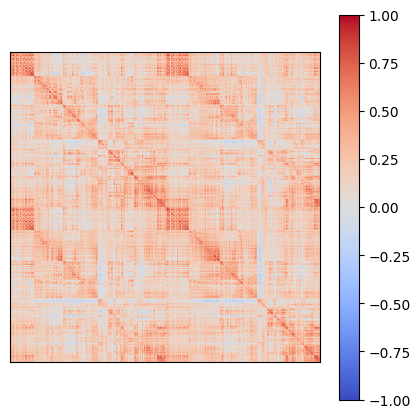

In [22]:
fig, ax = plt.subplots(figsize=(5, 5))
plt.imshow(dec_mat_2.cpu().detach().numpy(), cmap='coolwarm', vmax=1, vmin=-1)
plt.colorbar()
ax.set_xticks([])
ax.set_yticks([])
fig.savefig(f"./abstract_viz/dec2_matrix.svg", format = "svg", dpi = 300, bbox_inches='tight')

### Learning Curve

In [23]:
data_type = "embeddings"
target = 'nihtbx_totalcomp_agecorrected'
target_pred = f'{target}_pred'
exp_name =  cfg.experiment_name
exp_dir = f'{results_path}/{exp_name}'
 

In [24]:
predictions = pd.read_csv(f'{exp_dir}/pred_results.csv')

In [25]:
train_rows = predictions[predictions['dataset'] == 'train']

train_sizes = train_rows.groupby(['train_ratio', 'model_run']).apply(
    lambda group: int(len(group['indices']) * group['train_ratio'].iloc[0])
).reset_index(name='train_size')

predictions = predictions.merge(train_sizes, on=['train_ratio', 'model_run'], how='left')

/tmp/slurm-24296530/ipykernel_1601237/1412843934.py:3: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  train_sizes = train_rows.groupby(['train_ratio', 'model_run']).apply(


In [26]:
predictions['MAPE'] = (predictions[target] - predictions[target_pred]).abs()/predictions[target] * 100

In [27]:
correlations = (
    predictions.groupby(["train_size", "model_run", "dataset"])
    .apply(lambda group: group[[target, target_pred]].corr("spearman").iloc[0, 1])
    .reset_index(name='correlation')
)

/tmp/slurm-24296530/ipykernel_1601237/4285313903.py:3: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  .apply(lambda group: group[[target, target_pred]].corr("spearman").iloc[0, 1])


/gpfs3/well/margulies/users/cpy397/python/neuro/lib/python3.11/site-packages/seaborn/_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/gpfs3/well/margulies/users/cpy397/python/neuro/lib/python3.11/site-packages/seaborn/_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)


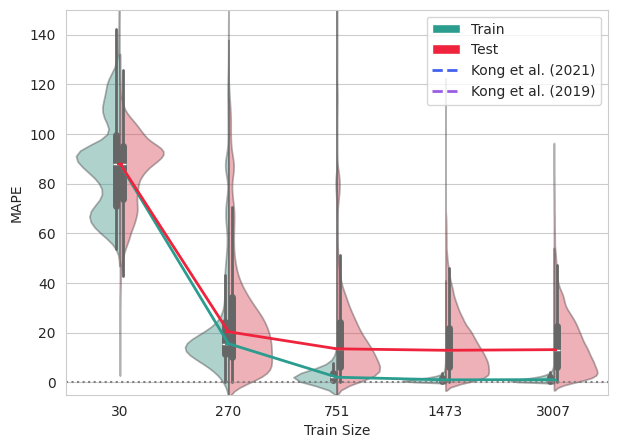

In [28]:
from matplotlib.patches import Patch
from matplotlib.lines import Line2D


plt.figure(figsize=(7, 5))
sns.set_style("whitegrid")
ax = sns.violinplot(data=predictions,
                    x="train_size",
                    y="MAPE",
                    hue="dataset",
                    hue_order=['train', 'test'],
                    split=True,
                    density_norm="width",
                    palette=['#2a9d8f', '#ef233c'],
                    inner_kws=dict(box_width=5, whis_width=2, color="0.4"),
                    legend = False
                    )

for patch in ax.collections:
    patch.set_alpha(0.4)

sns.pointplot(x='train_size', y='MAPE', hue='dataset',
                data=predictions.groupby(['train_size', 'dataset'], as_index=False)['MAPE'].median(),
                ax=ax, hue_order=['train', 'test'],
                markers="_",
                linewidth = 2,
                palette=['#2a9d8f', '#ef233c'],
                legend = False)
plt.axhline(0, c='grey', ls = ':')
plt.xlabel("Train Size")
custom_legend = [
    Patch(facecolor='#2a9d8f', label='Train'),
    Patch(facecolor='#ef233c', label='Test'),
    Line2D([0], [0], color='#4361ee', linestyle='--', linewidth=2, label='Kong et al. (2021)'),
    Line2D([0], [0], color='#9b5de5', linestyle='--', linewidth=2, label='Kong et al. (2019)')
]
ax.legend(handles=custom_legend, loc='upper right')

plt.ylim((-5, 150))
plt.savefig(f"./abstract_viz/lc_MAPE_ext.svg", format = "svg", dpi = 300, bbox_inches='tight')



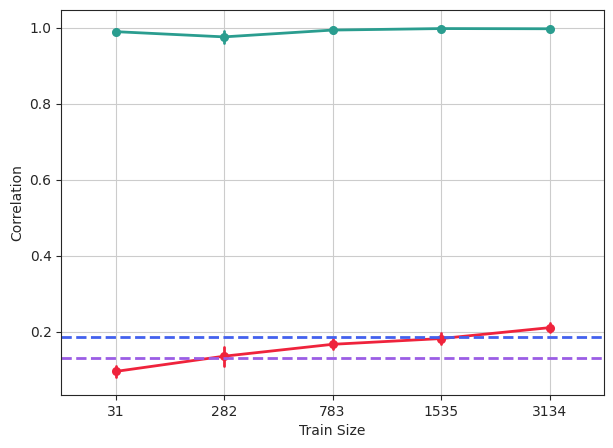

In [43]:
plt.figure(figsize=(7, 5))
sns.set_style("ticks")

sns.pointplot(x='train_size', y='correlation', hue='dataset',
                data=correlations,
                hue_order=['train', 'test'],
                markers="o",
                errorbar='sd',
                linewidth=2,
                palette=['#2a9d8f', '#ef233c'],
                legend = False)

ax.legend(handles=custom_legend, loc='center right')
# add a line with specified standard deviation
plt.axhline(0.1848, c='#4361ee', ls = '--', linewidth=2)
plt.axhline(0.1321, c='#9b5de5', ls = '--', linewidth=2)

custom_legend = [
    Patch(facecolor='#2a9d8f', label='Train'),
    Patch(facecolor='#ef233c', label='Test'),
    Line2D([0], [0], color='#4361ee', linestyle='--', linewidth=2, label='Kong et al. (2021)'),
    Line2D([0], [0], color='#9b5de5', linestyle='--', linewidth=2, label='Kong et al. (2019)')
]

plt.ylabel("Correlation")
plt.xlabel("Train Size")

plt.savefig(f"./abstract_viz/lc_corr_ext.svg", format = "svg", dpi = 300, bbox_inches='tight')

plt.grid()

### Matrix Reconstruction

In [152]:
mode = "shuffle"
domain = "cog"
dataset_name = "hcp"
train_ratio = 1.0
exp_name = f"{mode}_redmat_dec_{dataset_name}_multivar_{domain}_only"
exp_dir = f'./results/{exp_name}'
recon_dir = f'{exp_dir}/recon_mat'

In [153]:
exp_name

'shuffle_redmat_dec_hcp_multivar_cog_only'

In [100]:
if mode == 'shuffle':
    n_runs = cfg.random_seed
    run_type = "seed"
    test_type = "test"
else:
    n_runs = np.arange(cfg.kfolds)
    run_type = "fold"
    test_type = "validation"

In [106]:
for run in n_runs:
    print(np.load(f'{recon_dir}/recon_mat_{run_type}{run}_train_ratio{train_ratio}.npy').shape)

(305, 400, 400)
(305, 400, 400)
(306, 400, 400)
(303, 400, 400)
(307, 400, 400)
(303, 400, 400)
(303, 400, 400)
(305, 400, 400)
(303, 400, 400)
(303, 400, 400)


In [95]:
predictions = pd.read_csv(f'{exp_dir}/pred_results.csv')

In [108]:
exp_dir

'./results/shuffle_redmat_dec_hcp_multivar_cog_only'

In [ ]:
test_idx = np.concatenate([np.load(f'{exp_dir}/{test_type}_idx_{run_type}{run}_train_ratio{train_ratio}.npy') for run in n_runs])
recon_mat = np.concatenate([np.load(f'{recon_dir}/recon_mat_{run_type}{run}_train_ratio{train_ratio}.npy') for run in n_runs], axis = 0)
mape_mat = np.concatenate([np.load(f'{recon_dir}/mape_mat_{run_type}{run}_train_ratio{train_ratio}.npy') for run in n_runs], axis = 0)
true_mat = np.stack([dataset.matrices.isel(index = idx).values for idx in test_idx])

In [174]:
subj_atlas = np.array([np.concatenate([kong_parcellation['lh_labels_all'].T[idx], kong_parcellation['rh_labels_all'].T[idx]]) for idx in test_idx])

In [ ]:
median_mape_labeled = []
for true, recon, mape in zip(true_mat, recon_mat, mape_mat):
    true_copy, recon_copy, mape_copy = true.copy(), recon.copy(), mape.copy()
    np.fill_diagonal(true_copy, 0)
    np.fill_diagonal(recon_copy, 0)
    robust_mean_mape_regions = np.zeros(400)
    for i in range(400):
        robust_mean_mape_regions[i] = Huber().fit(mape[i])
    mean_mape_regions_mapped = map_to_labels(mean_mape_regions, schaefer_labels, mask=schaefer_labels != 0, fill=np.nan)
    median_mape_labeled.append(mean_mape_regions_mapped)
median_mape_labeled = np.array(median_mape_labeled)

In [156]:
def compute_batch_elementwise_correlation(true, recon):
    batch_size, rows, cols = true.shape
    correlations = np.zeros((rows, cols))

    flat_true = true.reshape(batch_size, -1)
    flat_recon = recon.reshape(batch_size, -1)
    
    for i in range(rows * cols):
        correlations[i // cols, i % cols] = spearmanr(flat_true[:, i], flat_recon[:, i])[0]
        
    np.fill_diagonal(correlations, 1.0)

    return correlations

In [157]:
recon_corr_mat = compute_batch_elementwise_correlation(true_mat, recon_mat)

/Users/VictoriaShevchenko/opt/miniconda3/envs/neuro/lib/python3.9/site-packages/scipy/stats/_stats_py.py:4916: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(warn_msg))


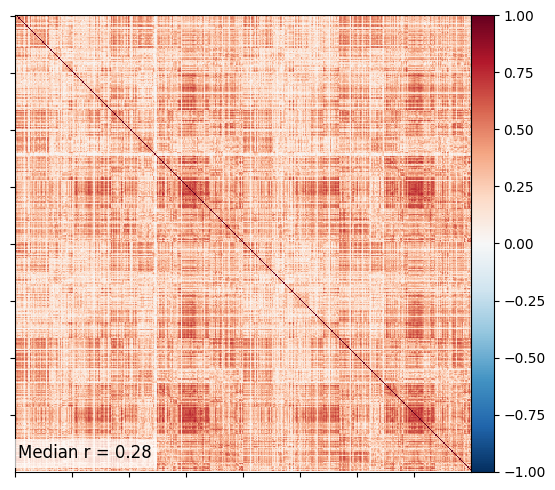

In [158]:
plotting.plot_matrix(recon_corr_mat,
    # title=f"Corr(True, Recon)",
                     grid = False,
                     vmax = 1.,
                     vmin = -1.
    )
# Calculate the mean correlation value
median_corr = np.median(recon_corr_mat)
# Add text annotation for the mean correlation value
plt.text(-14, 0.02, f'Median r = {median_corr:.2f}', color='black', ha='right', va='bottom', fontsize=12, transform=plt.gca().transAxes,
        bbox=dict(facecolor='white', alpha=0.7, edgecolor='none'))

plt.savefig(f"{fig_dir}/corr_true_recon_{dataset_name}_{domain}.svg", format = "svg", dpi = 300, bbox_inches='tight')


In [60]:
mat_corr_regions_mean = np.mean(mean_recon_across_runs, axis = 0)
mean_corr_regions_mapped = map_to_labels(mat_corr_regions_mean, schaefer_labels, mask=schaefer_labels != 0, fill=np.nan)
np.save(f'{fig_dir}/mean_corr_regions_mapped_{dataset_name}_{domain}.npy', mean_corr_regions_mapped)

In [159]:
huber_estimator = Huber(maxiter = 1000)

In [162]:
robust_mean_mape_mat = np.empty((400, 400))
for i in range(400):
    for j in range(400):
        robust_mean_mape_mat[i, j], _ = huber_estimator(mape_mat[:, i, j], initscale=np.array(10000))

np.save(f'{fig_dir}/robust_mean_mape_mat_{dataset_name}_{domain}.npy', robust_mean_mape_mat)

In [ ]:
robust_mean_mape_mat = np.load(f'{fig_dir}/robust_mean_mape_mat{dataset_name}_{domain}.npy')

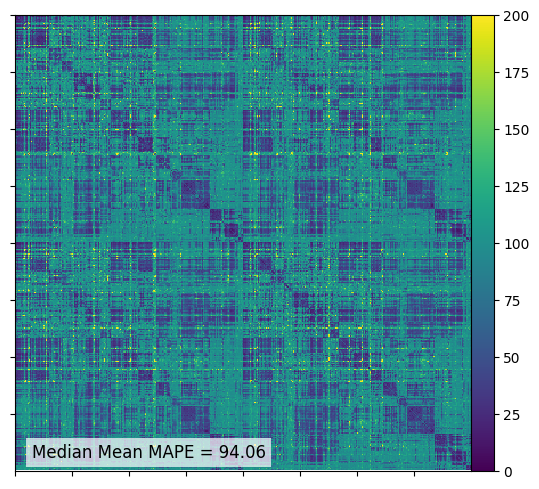

In [164]:
plotting.plot_matrix(robust_mean_mape_mat,
                     grid = False,
                     vmin = 0,
                     vmax = 200,
                     cmap='viridis'
    )
# Calculate the mean correlation value
median_mean_mape = np.median(robust_mean_mape_mat)
# Add text annotation for the mean correlation value
plt.text(-9, 0.02, f'Median Mean MAPE = {median_mean_mape:.2f}', color='black', ha='right', va='bottom', fontsize=12, transform=plt.gca().transAxes,
        bbox=dict(facecolor='white', alpha=0.7, edgecolor='none'))

plt.savefig(f"{fig_dir}/robust_mean_mape_mat_{dataset_name}_{domain}.svg", format = "svg", dpi = 300, bbox_inches='tight')

In [64]:
mean_mape_regions = np.mean(robust_mean_mape_mat.mean(axis=0), axis = 0)
mean_mape_regions_mapped = map_to_labels(mean_mape_regions, schaefer_labels, mask=schaefer_labels != 0, fill=np.nan)
np.save(f'{fig_dir}/mean_mape_regions_mapped_{dataset_name}_{domain}.npy', mean_mape_regions_mapped)

In [ ]:
mean_mape_regions_mapped = np.load(f'{fig_dir}/mean_mape_regions_mapped_{dataset_name}_{domain}.npy')

In [65]:
# sns.histplot(sym_matrix_to_vec(mape_mat, discard_diagonal=True).flatten(), bins=100, log_scale = True)
# median = np.median(sym_matrix_to_vec(mape_mat, discard_diagonal=True).flatten())
# plt.axvline(median, color='r', linestyle='--', linewidth=2, label=f'Median: {median:.2f}')
# plt.xlim(10**-2, 10**5)
# plt.legend()
# plt.savefig(f"./abstract_viz/mat_mape_dist{filename_suffix}.svg", format = "svg", dpi = 300, bbox_inches='tight')

In [ ]:
def map_matrix_on_cortex(matrix, parcellation, type):
    np.fill_diagonal(matrix, 0)
    mean_regions = np.median(matrix, axis = 0)

In [69]:
median_mape_labeled = []
for m in mape_mat:
    mat = m.copy()
    np.fill_diagonal(mat, 0)
    mean_mape_regions = np.median(mat, axis = 0)
    mean_mape_regions_mapped = map_to_labels(mean_mape_regions, schaefer_labels, mask=schaefer_labels != 0, fill=np.nan)
    median_mape_labeled.append(mean_mape_regions_mapped)
median_mape_labeled = np.array(median_mape_labeled)

### Plotting on Surfaces

In [96]:
kong_parcellation['rh_labels_all'][:, 0].shape

(32492,)

In [85]:
atlas_labels = nl.datasets.fetch_atlas_schaefer_2018(yeo_networks=17)['labels']
atlas_labels = [label.decode('utf-8') for label in atlas_labels]
NETWORK_LABELS = ['VisCent', 'VisPeri',  'SomMotA', 'SomMotB', 'DorsAttnA', 'DorsAttnB',
                  'SalVentAttnA', 'SalVentAttnB', 'LimbicA', 'LimbicB', 'ContA', 'ContA',
                  'DefaultA', 'DefaultB','TempPar']
NETWORK_LABELS = [replace_with_network(label, NETWORK_LABELS) for label in atlas_labels]

In [86]:
# replace with unique numbers from 1 to 7 in the list

mapping = list(set(NETWORK_LABELS))
mapping = {mapping[i]: float(i) for i in range(len(mapping))}

NETWORK_LABELS_NUMBERED = np.array([mapping[label] for label in NETWORK_LABELS])

In [107]:
sub_parc = np.concatenate((kong_parcellation['lh_labels_all'][:, 5], kong_parcellation['rh_labels_all'][:, 5]))

In [108]:
NETWORK_LABELS_NUMBERED_SURF = map_to_labels(kong_parcellation['colors'].mean(axis = 1), sub_parc, mask=sub_parc != 0, fill=np.nan)

In [19]:
filename_suffix = ''

In [42]:
mean_mape_regions_mapped = np.load(f'./viz/mape_mat_all_hcp_mapped.npy')
recon_regions_mapped = np.load(f'./viz/recon_conn_mat_all_hcp_mapped.npy')
true_regions_mapped = np.load(f'./viz/true_conn_mat_all_hcp_mapped.npy')

In [21]:
region_recon_corr = np.array([spearmanr(true_regions_mapped[:, i], recon_regions_mapped[:, i])[0] for i in range(recon_regions_mapped.shape[1])])

In [16]:
region_recon_corr

array([0.3689994 , 0.46807337, 0.33692429, ..., 0.17930136, 0.17930136,
       0.17930136])

In [22]:
mean_mape_regions_mapped.mean(axis = 0)

array([705.73755, 372.0096 , 590.92645, ..., 388.39572, 365.4245 ,
       368.4955 ], dtype=float32)

In [28]:
spearmanr(true_regions_mapped[:, 0], recon_regions_mapped[:, 0])

SignificanceResult(statistic=0.5463868537142628, pvalue=2.2727424472009083e-25)

In [38]:
np.nanmin(mean_mape_regions_mapped, axis=0)

/var/folders/2m/72fcyjmd7vs3g18rkfwx7nw40000gn/T/ipykernel_7424/1348715633.py:1: RuntimeWarning: All-NaN slice encountered
  np.nanmin(mean_mape_regions_mapped, axis=0)


array([88.7721  , 74.84583 , 81.179665, ..., 82.12627 , 82.12627 ,
       82.12627 ], dtype=float32)

In [66]:
# robust huber mean
from statsmodels.robust.scale import Huber
huber_estimator = Huber(maxiter = 1000000) 
robust_mean_mape_regions_mapped = np.empty((mean_mape_regions_mapped.shape[1]))
for i in range(mean_mape_regions_mapped.shape[1]):
    robust_mean_mape_regions_mapped[i], _ = huber_estimator(mean_mape_regions_mapped[:, i], initscale=np.array(1000))

ValueError: joint estimation of location and scale failed to converge in 1000000 iterations

Text(0.5, 1.0, 'Vertex-wise MAPE: STD')

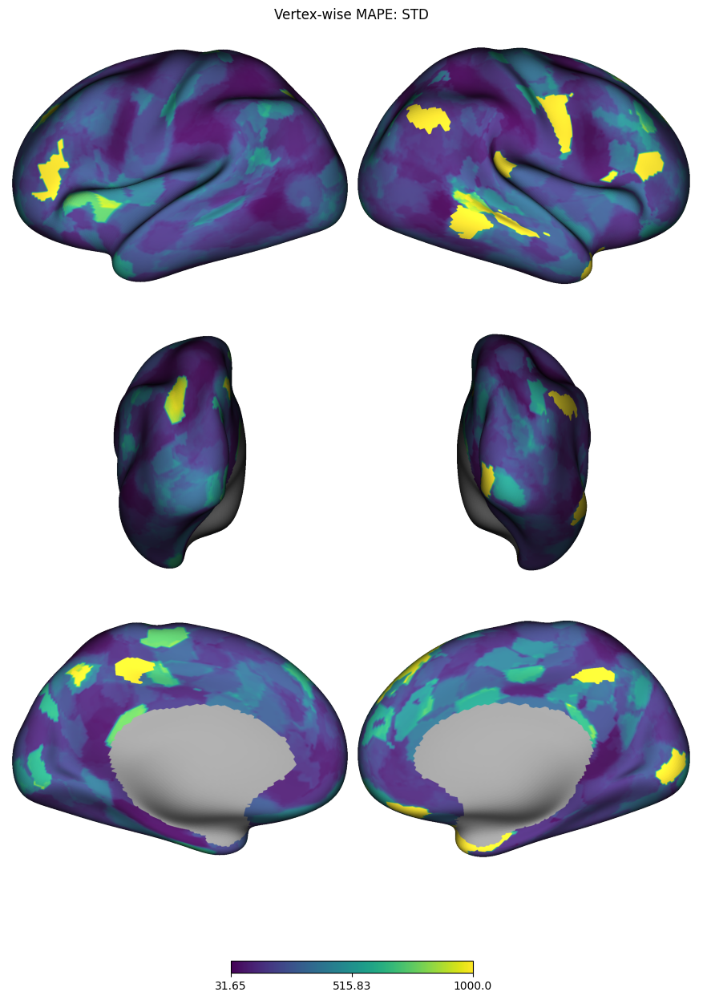

In [72]:

mape_plot = Plot(lh, rh, size=(1200, 1500), brightness=0.5, views=['lateral', 'posterior', 'medial'])
mape_plot.add_layer({'left': mean_mape_regions_mapped.mean(axis = 0)[:32492],
                     'right': mean_mape_regions_mapped.mean(axis = 0)[32492:]},
                     cbar=True, cmap="viridis", 
                     color_range=(np.nanmin(mean_mape_regions_mapped.std(axis = 0)), 1000),
                     zero_transparent=False,
                     alpha=1
)

fig = mape_plot.build()
fig.axes[0].set_title('Vertex-wise MAPE: STD', pad=-3)
# fig.savefig(f"viz/std_mape_regions_mapped.png", format = "png", dpi = 300, bbox_inches='tight')

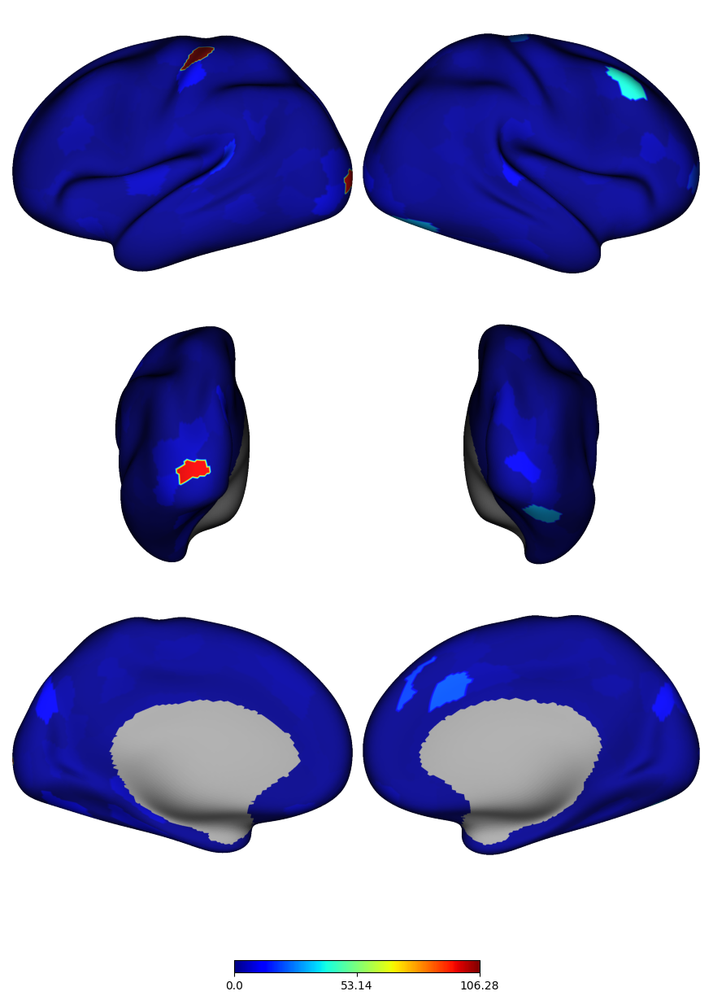

In [61]:
# mean_mape_regions_mapped = np.load(f"{fig_dir}/mean_mape_regions_mapped{filename_suffix}.npy")
mape_plot = Plot(lh, rh, size=(1200, 1500), brightness=0.5, views=['lateral', 'posterior', 'medial'])
mape_plot.add_layer({'left': np.abs((true_regions_mapped[200]-recon_regions_mapped[200])/true_regions_mapped[200])[:32492],
                     'right': np.abs((true_regions_mapped[200]-recon_regions_mapped[200])/true_regions_mapped[200])[32492:]},
                     cbar=True, cmap="jet", 
                     zero_transparent=False,
                     alpha=1
)
fig = mape_plot.build()
# fig.savefig(f"{fig_dir}/mean_mape_regions_mapped{filename_suffix}.svg", format = "svg", dpi = 300, bbox_inches='tight')

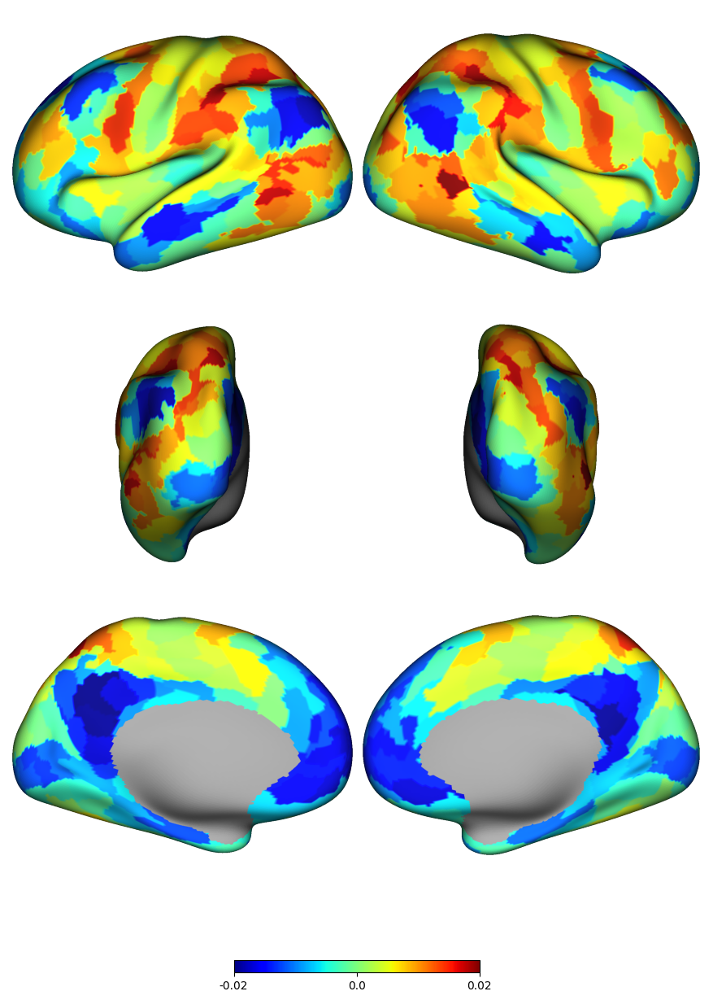

In [29]:
mape_plot = Plot(lh, rh, size=(1200, 1500), brightness=0.5, views=['lateral', 'posterior', 'medial'])
mape_plot.add_layer({'left': recon_regions_mapped[100][:32492],
                     'right': recon_regions_mapped[100][32492:]},
                     cbar=True, cmap="jet", 
                     zero_transparent=False,
                    #  color_range=(0, 0.2),
                     alpha=1
)
# mape_plot.add_layer({'left': NETWORK_LABELS_NUMBERED_SURF[:32492],
#                      'right': NETWORK_LABELS_NUMBERED_SURF[32492:]}, cmap='gray',
#             as_outline=True, cbar=False)
fig = mape_plot.build()

Text(0.5, 1.0, 'Vertex-wise correlation: True Conn vs. Recon + Suject Parcellation Outline')

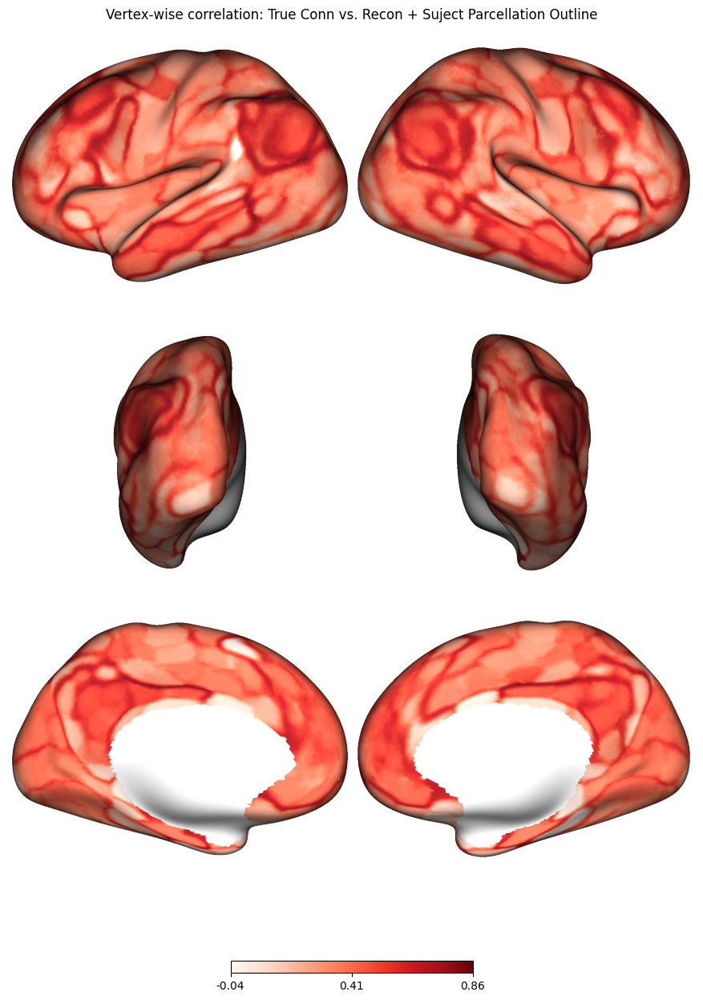

In [22]:
mape_plot = Plot(lh, rh, size=(1200, 1500), brightness=1.0, views=['lateral', 'posterior', 'medial'])
mape_plot.add_layer({'left': region_recon_corr[:32492],
                     'right': region_recon_corr[32492:]},
                     cbar=True, cmap="Reds", 
                     zero_transparent=False,
                     alpha=1,

)
# mape_plot.add_layer({'left': NETWORK_LABELS_NUMBERED_SURF[:32492],
#                      'right': NETWORK_LABELS_NUMBERED_SURF[32492:]}, cmap='gray',
#             as_outline=True, cbar=False)
fig = mape_plot.build()
fig.axes[0].set_title('Vertex-wise correlation: True Conn vs. Recon + Suject Parcellation Outline', pad=-3)
# fig.savefig(f"viz/corr_regions_mapped_parc_outline{filename_suffix}.png", format = "png", dpi = 300, bbox_inches='tight')

0 10
1 17
2 29
3 66
4 67
5 74
6 95
7 113
8 122
9 131


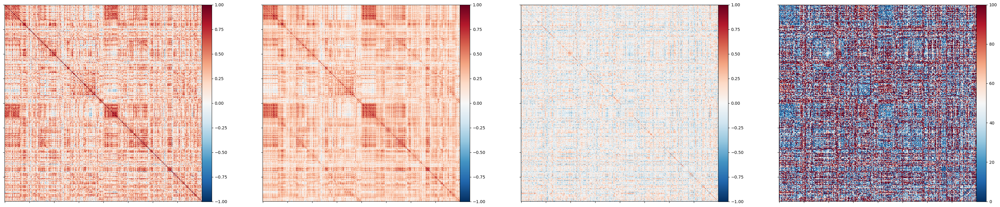

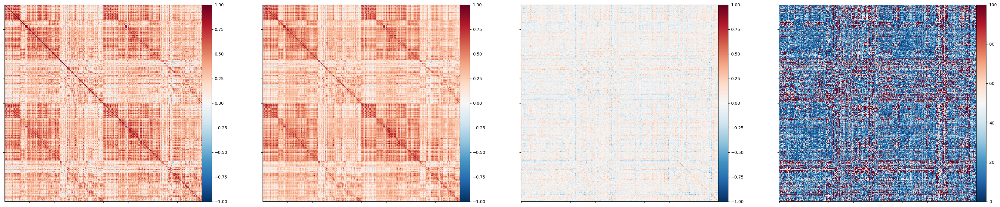

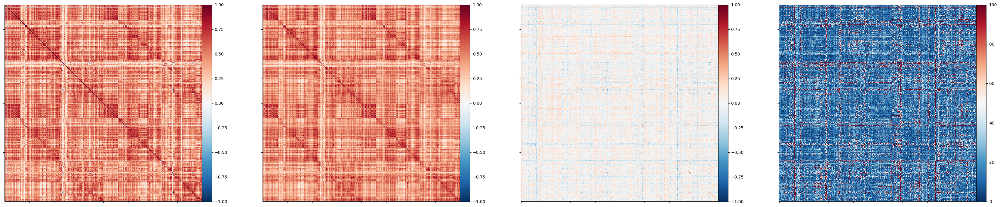

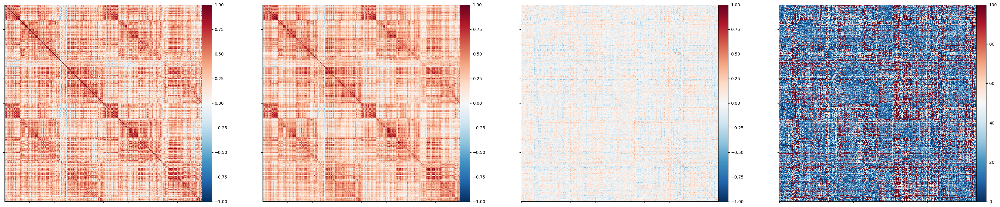

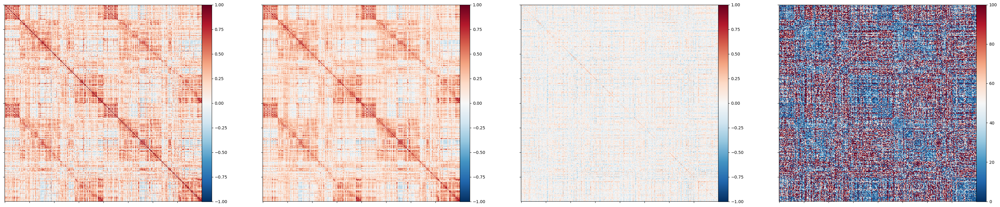

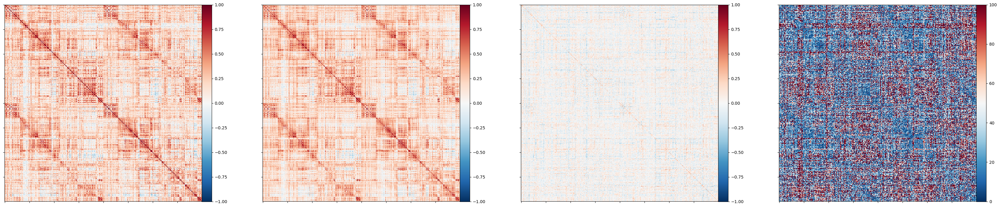

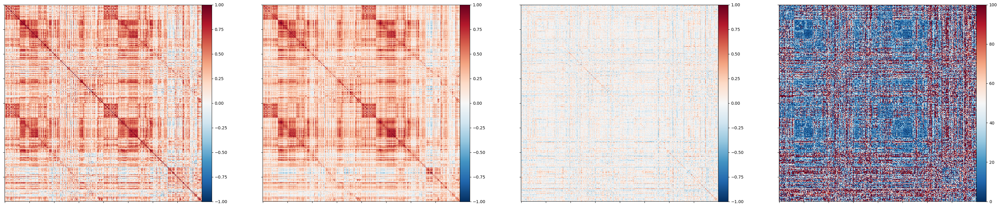

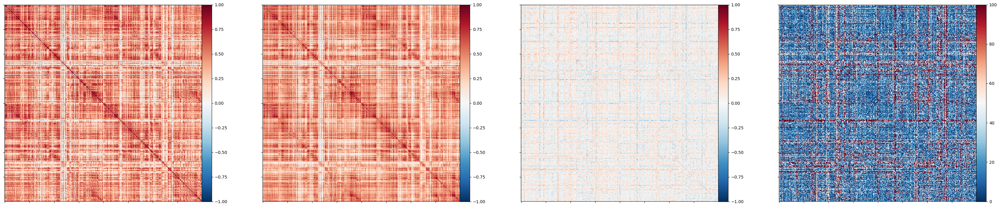

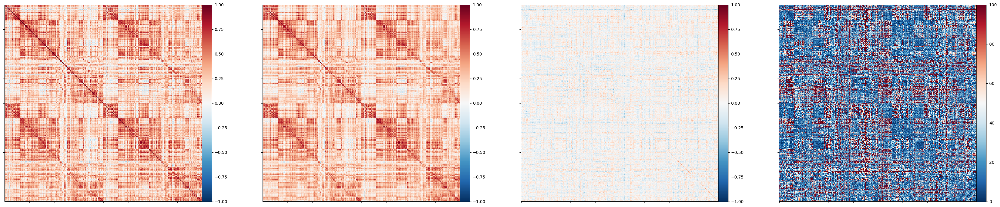

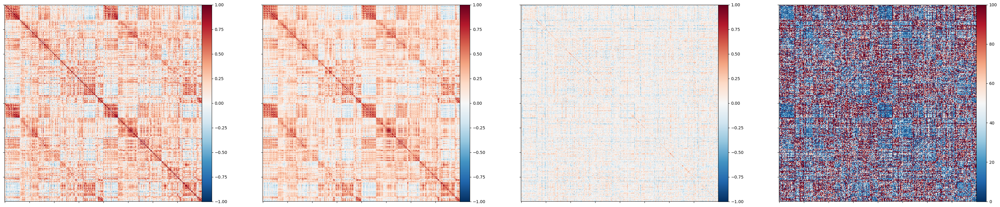

In [54]:
count = 0
for i, mat_idx in enumerate(overlap_test_idx[:10]):
        idx = np.where(test_idx == mat_idx)[0][0]
        recon = recon_mat[idx]
        mape = mape_mat[idx]
        true = dataset.matrices.isel(subject = mat_idx).values

        residual = true - recon

        fig, axes = plt.subplots(1, 4, figsize=(36, 7))

        plotting.plot_matrix(true,
        axes = axes[0],
        vmax = 1.,
        vmin = -1.,
        )

        plotting.plot_matrix(recon,
        axes = axes[1],
        vmax = 1.,
        vmin = -1.,        
        )

        plotting.plot_matrix(residual,
        axes = axes[2],
        vmax = 1.,
        vmin = -1.,   
        )

        plotting.plot_matrix(mape,
        axes = axes[3],
        vmax = 100, vmin=0
        )
        plt.savefig(f"./abstract_viz/individual_recon_idx{mat_idx}{filename_suffix}.svg", format = "svg", dpi = 300, bbox_inches='tight')


In [56]:
true_mat_vec = sym_matrix_to_vec(true_mat, discard_diagonal = True)
recon_mat_vec = sym_matrix_to_vec(recon_mat, discard_diagonal = True)

In [60]:
sim_null_dist = []
for i in tqdm(range(10)):
    shuffled_recon = recon_mat_vec.copy()
    np.random.shuffle(shuffled_recon)
    sim = np.diag(cosine_similarity(recon_mat_vec, shuffled_recon)).mean()
    sim_null_dist.append(sim)
sim_null_dist = np.array(sim_null_dist)

100%|█████████████████████████████████████████████████████████████████████| 10/10 [05:53<00:00, 35.32s/it]


In [61]:
sim_null_dist

array([0.6893528 , 0.69074255, 0.6894885 , 0.68904436, 0.69011223,
       0.6886922 , 0.6904257 , 0.6904854 , 0.68943465, 0.69275093],
      dtype=float32)

In [ ]:
np.concatenate(sim_null_dist, np.diag(cosine_similarity(recon_mat_vec, true_mat_vec)).mea)

In [62]:
np.diag(cosine_similarity(recon_mat_vec, true_mat_vec)).mean()

np.float64(0.8782642169059856)

### Embedding Viz

In [36]:
embedding_dir = f'{exp_dir}/embeddings'

In [37]:
run = 15

In [38]:
emb_train = np.load(f"{embedding_dir}/joint_embeddings_run{run}_test.npy")

In [39]:
tsne = TSNE()
viz_emb_train = tsne.fit_transform(emb_train)

In [40]:
true_target = predictions[(predictions["dataset"]=='test') & (predictions["model_run"]==run)& (predictions["train_ratio"]==1.0)][target].values

In [41]:
true_target

array([112.,  86.,  93., ..., 108., 118.,  99.])

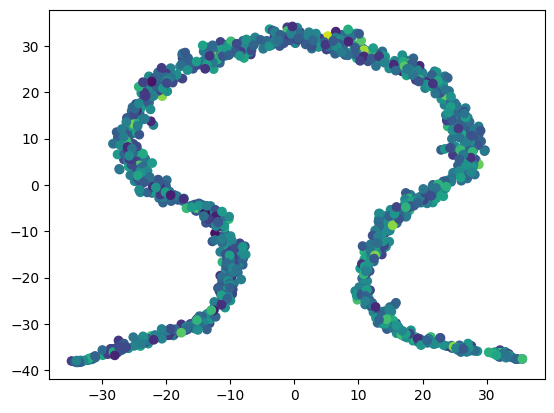

In [151]:
xs = viz_emb_train[:, 0]
ys = viz_emb_train[:, 1]
plt.scatter(xs, ys, c = true_target)